In [1]:
from PIL import Image
import h5py
import anubisPlotUtils as anPlot
import json
import numpy as np
import os
import hist as hi
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as colors
matplotlib.use('TkAgg')  # or 'Qt5Agg', 'GTK3Agg', etc.
import mplhep as hep
hep.style.use([hep.style.ATLAS])
import sys
import ANUBIS_triggered_functions as ANT
import pandas as pd
import matplotlib.backends.backend_pdf
from matplotlib.ticker import MultipleLocator
import plotly
import plotly.graph_objs as go
import plotly.express as px
import csv 


%matplotlib inline
current_directory=  os.path.dirname(os.getcwd())

In [50]:
def reconstruct(event,max_cluster_size):
    max_residual = 100

    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]
    RPC_heights = [0.6,1.8,3.0,61.8,121.8,123] #Heights of middle point of each RPC, measured from the bottom of the Triplet Low RPC. Units are cm.

    #Extract x and y coords of cluster in event

    coords = ANT.extract_coords(event,max_cluster_size)

     # Count the number of empty RPCs
    empty_RPC_count = sum(1 for item in coords if item == [[], []])

    # # Count the number of non-empty RPCs at the beginning of the coords list
    # non_empty_count = sum(1 for item in coords[:3] if item != [[], []])

    # # If there are only three non-empty RPCs at the beginning, exit the function
    # if empty_RPC_count >= 3 and non_empty_count == 3:
    #     print("Failed to reconstruct, not enough chambers crossed")
    #     return None  # Exit the function

    # If less than 3 elements of coords are occupied, exit the function
    if empty_RPC_count > 3:
        print("Failed to reconstruct, not enough coords")
        return None  # Exit the function

    #ITERATING OVER EVERY POSSIBLE COMBINATION OF x,y,z over all 3 RPCs (limited to one x,y per RPC).
    #Doesn't look particularly nice, but there are not many coordinates to loop over usually....

    combinations = ANT.generate_hit_coords_combo(coords,RPC_heights)

    #Now for each combo in combinations, attempt to reconstruct a path. See which one gives the best trajectory.

    #If success, print parameters of fitting function.
    #If fail, print reconstruction failed.

    residuals_current = np.inf
    optimised_coords = None
    optimised_d= None
    optimised_centroid= None

    for ind,combo in enumerate(combinations):

        centroid, d, residuals = ANT.fit_event(combo)
        if residuals < residuals_current:

            # If new fit is better than old then replace old fit.
            residuals_current = residuals
            optimised_centroid = centroid
            optimised_d = d
            optimised_coords = combinations[ind]

    #FLIP VECTOR SO IT POINTS DOWN!
    #Just minor fix for now. In future, find average time of cluster in highest plate and compare with lowest hit plate to
    #determine the vertical direction of a track.
    
    if optimised_d[2]  > 0:
        optimised_d = np.multiply(optimised_d,-1)

    # if residuals_current<max_residual:
    return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current
    # else:
    #     print("Failed to reconstruct, residuals too large")
    #     #return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current
    #     return None

In [2]:
current_directory=  os.path.dirname(os.getcwd())

data = ANT.importDatafile(current_directory+"\\ProAnubisData\\ATLAS LUMINOSITY\\proAnubis_240403_0227.h5")

In [3]:
data_ATLAS = [sublist[:94230] for sublist in data]
etaHits, phiHits = ANT.divideHitCountsByRPC_Timed(data_ATLAS)

In [4]:
#Time_window for coincidence set at 15 ns.
#Temporal Clustering
coincident_hits_ATLAS = ANT.FindCoincidentHits(etaHits,phiHits,15)

#Spatial Clustering
coincident_hits_ATLAS_clustered = ANT.cluster(coincident_hits_ATLAS)

0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0

In [5]:
#Filter events depending on what you would like to look at.
#filter_events(data,minimum number of chambers hit, minimum number of RPCs hit)
cross_chamber_3_RPC_events = ANT.filter_events(coincident_hits_ATLAS_clustered,2,3)
print("......")

Number of events in filter = 27227
......


In [51]:
residuals = []

for event in cross_chamber_3_RPC_events:
    
    x = reconstruct(event,3)

    if x:

        residuals.append(x[4])

[[120.16875, 79.0866, 1.8], [129.8375, 82.071, 61.8], [136.74375, 68.6412, 123]]
[[120.16875, 79.0866, 1.8], [149.175, 82.071, 61.8], [136.74375, 68.6412, 123]]
[[62.15625000000001, 70.1334, 0.6], [62.15625000000001, 70.1334, 1.8], [62.15625000000001, 70.1334, 3.0], [96.6875, 43.2738, 61.8]]
[[136.74375, 76.1022, 0.6], [136.74375, 76.1022, 1.8], [136.74375, 77.59440000000001, 3.0], [147.79375000000002, 88.0398, 61.8], [154.70000000000002, 94.0086, 121.8]]
[[114.64375000000001, 25.3674, 1.8], [113.26250000000002, 25.3674, 3.0], [117.40625000000001, 49.242599999999996, 123]]
[[81.49375, 43.2738, 0.6], [82.875, 43.2738, 1.8], [82.875, 44.766000000000005, 3.0], [89.78125, 55.2114, 61.8], [92.54375, 61.18019999999999, 121.8], [91.1625, 61.1802, 123]]
[[69.0625, 19.3986, 0.6], [69.0625, 19.3986, 1.8], [73.20625000000001, 40.2894, 61.8]]
[[89.78125, 35.812799999999996, 0.6], [89.78125, 35.812799999999996, 1.8], [89.78125, 37.305, 3.0], [89.78125, 74.61, 123]]
[[89.78125, 35.812799999999996, 0

In [19]:
print(len(residuals))

26524


In [15]:
print(np.median(residuals))

1.2878152334257669


In [31]:
r = [x for x in residuals if x<100]

In [32]:
print(len(r))

26005


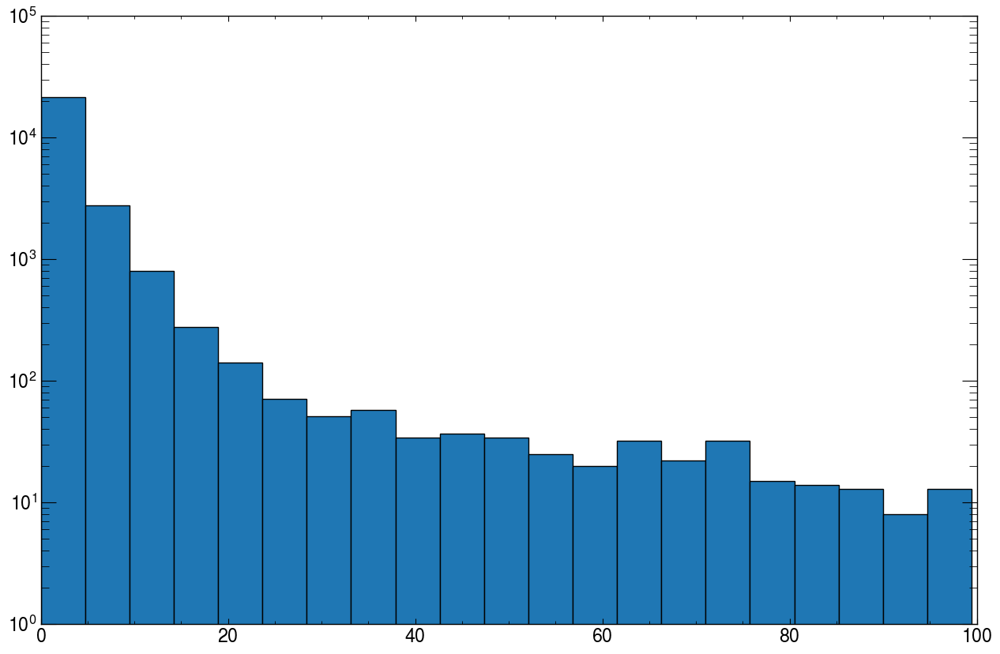

In [47]:
plt.figure(figsize=(15,10))

plt.hist(r,density=False,edgecolor='black',bins=21)

plt.xlim(0,100)
plt.yscale('log')

plt.show()

In [38]:
#Filter events depending on what you would like to look at.
#filter_events(data,minimum number of chambers hit, minimum number of RPCs hit)
all_6_RPC_events = ANT.filter_events(coincident_hits_ATLAS_clustered,2,6)
print("......")

Number of events in filter = 1334
......


In [39]:
residuals_all6 = []

for event in all_6_RPC_events:
    
    x2 = reconstruct(event,3)

    if x2:

        residuals_all6.append(x2[4])

Failed to reconstruct, not enough coords
Failed to reconstruct, not enough coords
Failed to reconstruct, not enough coords
Failed to reconstruct, not enough coords
Failed to reconstruct, not enough coords
Failed to reconstruct, not enough coords
Failed to reconstruct, not enough coords
Failed to reconstruct, not enough coords
Failed to reconstruct, not enough coords


In [42]:
print(len(residuals_all6))

1325


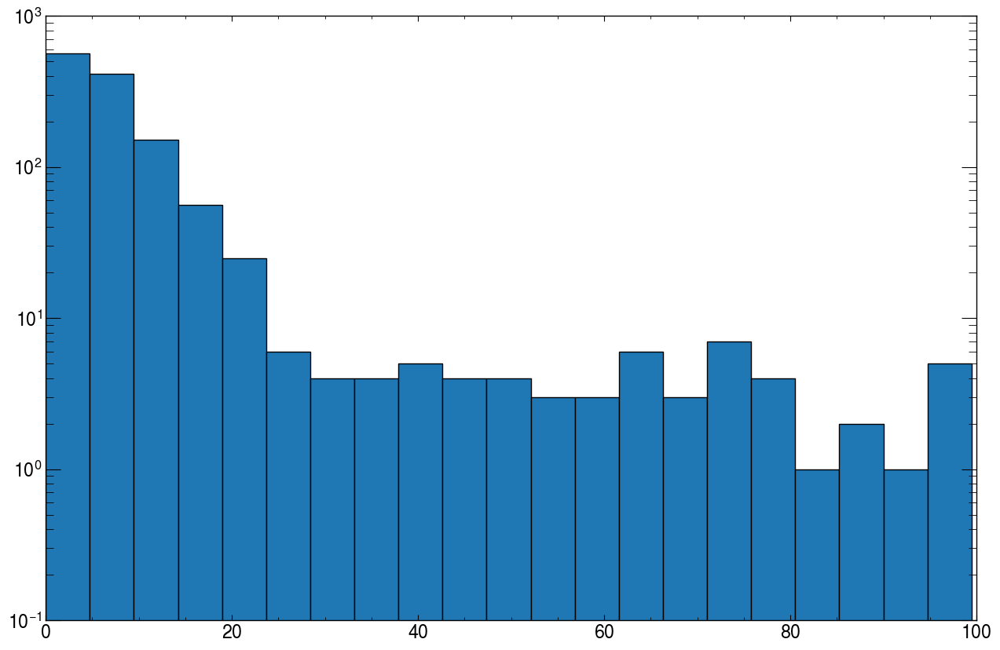

In [45]:
plt.figure(figsize=(15,10))

plt.hist(r2,density=False,edgecolor='black',bins=21)

plt.xlim(0,100)
plt.yscale('log')

plt.show()